In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
sns.set_style('whitegrid')
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 8
plt.rcParams['ytick.labelsize'] = 8
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 14
plt.rcParams['figure.figsize'] = (8, 6)
pd.options.mode.chained_assignment = None
pd.options.display.float_format = '{:.2f}'.format
pd.set_option('display.max_columns', 200)
pd.set_option('display.width', 400)
import warnings
warnings.filterwarnings('ignore')
import datetime
import pandas_profiling as pp
from sklearn.model_selection import train_test_split
from sklearn.ensemble import VotingRegressor, RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor, GradientBoostingRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import RobustScaler
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.base import clone
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
import lightgbm as lgb

In [2]:
df = pd.read_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\dataset\train.csv')
df.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
0,WM_33725,2019-08-04 14:33:20,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,nan,239.84,2730.31,42.08,BA,Medium,2.22,0.31,24.28,6.77
1,WM_698,2018-11-05 10:13:20,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,nan,337.94,1780.21,107.89,A2,Medium,4.21,0.45,27.26,5.97
2,WM_39146,2019-09-14 14:03:20,95.48,nan,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,ABC,Medium,2.72,0.30,27.37,2.87
3,WM_6757,2018-12-25 15:33:20,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,ABC,NaN,4.86,0.37,24.29,14.85
4,WM_21521,2019-05-04 03:13:20,10.72,nan,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,AAA,Medium,nan,0.45,27.97,3.52


In [3]:
df_test = pd.read_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\dataset\test.csv')
df_test.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m)
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,BA,Medium,3.19,0.40,25.57
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,nan,29.43,42.73,499.60,1165.11,-35.05,A,Medium,3.02,0.44,24.37
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,B2,Medium,2.61,0.39,27.65
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,nan,23.89,13.50,nan,1329.74,15.25,BBB,Low,2.87,0.45,24.19
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,A,Low,3.55,0.37,4.89


In [4]:
# set target feature
targetFeature='windmill_generated_power(kW/h)'

In [5]:
# important funtions
def datasetShape(df):
    rows, cols = df.shape
    print("The dataframe has",rows,"rows and",cols,"columns.")
    
# select numerical and categorical features
def divideFeatures(df):
    numerical_features = df.select_dtypes(include=[np.number])
    categorical_features = df.select_dtypes(include=[np.object])
    return numerical_features, categorical_features

In [6]:
# check dataset shape
datasetShape(df)

The dataframe has 28200 rows and 22 columns.


In [7]:
# check for duplicates
print(df.shape)
df.drop_duplicates(inplace=True)
print(df.shape)

(28200, 22)
(28200, 22)


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28200 entries, 0 to 28199
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   tracking_id                     28200 non-null  object 
 1   datetime                        28200 non-null  object 
 2   wind_speed(m/s)                 27927 non-null  float64
 3   atmospheric_temperature(°C)     24750 non-null  float64
 4   shaft_temperature(°C)           28198 non-null  float64
 5   blades_angle(°)                 27984 non-null  float64
 6   gearbox_temperature(°C)         28199 non-null  float64
 7   engine_temperature(°C)          28188 non-null  float64
 8   motor_torque(N-m)               28176 non-null  float64
 9   generator_temperature(°C)       28188 non-null  float64
 10  atmospheric_pressure(Pascal)    25493 non-null  float64
 11  area_temperature(°C)            28200 non-null  float64
 12  windmill_body_temperature(°C)   

In [9]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12086 entries, 0 to 12085
Data columns (total 21 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   tracking_id                    12086 non-null  object 
 1   datetime                       12086 non-null  object 
 2   wind_speed(m/s)                11960 non-null  float64
 3   atmospheric_temperature(°C)    10659 non-null  float64
 4   shaft_temperature(°C)          12085 non-null  float64
 5   blades_angle(°)                11980 non-null  float64
 6   gearbox_temperature(°C)        12085 non-null  float64
 7   engine_temperature(°C)         12081 non-null  float64
 8   motor_torque(N-m)              12075 non-null  float64
 9   generator_temperature(°C)      12081 non-null  float64
 10  atmospheric_pressure(Pascal)   10935 non-null  float64
 11  area_temperature(°C)           12085 non-null  float64
 12  windmill_body_temperature(°C)  11160 non-null 

## EDA

In [10]:
profile = pp.ProfileReport(df, title='Pandas Profiling Report', explorative=True)
profile.to_file("profile.html")

In [11]:
profile.to_notebook_iframe()

In [12]:
cont_features, cat_features = divideFeatures(df)
cat_features

,tracking_id,datetime,turbine_status,cloud_level
0,WM_33725,2019-08-04 14:33:20,BA,Medium
1,WM_698,2018-11-05 10:13:20,A2,Medium
2,WM_39146,2019-09-14 14:03:20,ABC,Medium
3,WM_6757,2018-12-25 15:33:20,ABC,NaN
4,WM_21521,2019-05-04 03:13:20,AAA,Medium
...,...,...,...,...
28195,WM_7814,2019-01-02 02:43:20,BB,Medium
28196,WM_32512,2019-07-26 12:53:20,BB,Low
28197,WM_5193,2018-12-12 02:13:20,D,Medium
28198,WM_12173,2019-02-03 19:13:20,BCB,Low


In [13]:
cont_features

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
0,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,nan,239.84,2730.31,42.08,2.22,0.31,24.28,6.77
1,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,nan,337.94,1780.21,107.89,4.21,0.45,27.26,5.97
2,95.48,nan,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,2.72,0.30,27.37,2.87
3,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,4.86,0.37,24.29,14.85
4,10.72,nan,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,nan,0.45,27.97,3.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28195,94.77,23.58,45.40,5.38,-1.09,48.53,2791.60,90.90,19428.73,45.43,44.24,536.15,1980.86,45.91,2.77,0.42,24.59,9.59
28196,94.20,24.03,42.07,-99.00,44.29,43.49,2207.88,72.24,16596.49,25.14,43.62,354.24,1712.84,36.97,-3.25,0.46,26.05,4.52
28197,94.16,28.67,45.00,9.55,49.38,44.04,2801.66,94.81,19083.88,45.13,43.58,534.21,1951.73,88.32,nan,0.38,28.53,11.10
28198,95.43,26.56,48.03,3.05,81.44,44.82,2760.65,90.14,18360.79,45.60,44.97,568.50,1968.92,47.56,3.00,0.35,47.75,9.37


In [14]:
df.nunique()

tracking_id                       28200
datetime                          28200
wind_speed(m/s)                   27727
atmospheric_temperature(°C)       20809
shaft_temperature(°C)             27625
blades_angle(°)                   22830
gearbox_temperature(°C)           27911
engine_temperature(°C)            28188
motor_torque(N-m)                 27660
generator_temperature(°C)         28187
atmospheric_pressure(Pascal)      25492
area_temperature(°C)              28170
windmill_body_temperature(°C)     21893
wind_direction(°)                 22984
resistance(ohm)                   27365
rotor_torque(N-m)                 25945
turbine_status                       14
cloud_level                           3
blade_length(m)                   22833
blade_breadth(m)                  28200
windmill_height(m)                27657
windmill_generated_power(kW/h)    27988
dtype: int64

In [15]:
df_test.nunique()

tracking_id                      12086
datetime                         12086
wind_speed(m/s)                  11875
atmospheric_temperature(°C)       8988
shaft_temperature(°C)            11839
blades_angle(°)                   9820
gearbox_temperature(°C)          11952
engine_temperature(°C)           12081
motor_torque(N-m)                11856
generator_temperature(°C)        12081
atmospheric_pressure(Pascal)     10935
area_temperature(°C)             12075
windmill_body_temperature(°C)     9459
wind_direction(°)                 9885
resistance(ohm)                  11727
rotor_torque(N-m)                11128
turbine_status                      14
cloud_level                          3
blade_length(m)                   9849
blade_breadth(m)                 12086
windmill_height(m)               11831
dtype: int64

In [16]:
df.isna().sum()

tracking_id                          0
datetime                             0
wind_speed(m/s)                    273
atmospheric_temperature(°C)       3450
shaft_temperature(°C)                2
blades_angle(°)                    216
gearbox_temperature(°C)              1
engine_temperature(°C)              12
motor_torque(N-m)                   24
generator_temperature(°C)           12
atmospheric_pressure(Pascal)      2707
area_temperature(°C)                 0
windmill_body_temperature(°C)     2363
wind_direction(°)                 5103
resistance(ohm)                      1
rotor_torque(N-m)                  572
turbine_status                    1759
cloud_level                        276
blade_length(m)                   5093
blade_breadth(m)                     0
windmill_height(m)                 543
windmill_generated_power(kW/h)     207
dtype: int64

In [17]:
df_test.isna().sum()

tracking_id                         0
datetime                            0
wind_speed(m/s)                   126
atmospheric_temperature(°C)      1427
shaft_temperature(°C)               1
blades_angle(°)                   106
gearbox_temperature(°C)             1
engine_temperature(°C)              5
motor_torque(N-m)                  11
generator_temperature(°C)           5
atmospheric_pressure(Pascal)     1151
area_temperature(°C)                1
windmill_body_temperature(°C)     926
wind_direction(°)                2160
resistance(ohm)                     0
rotor_torque(N-m)                 281
turbine_status                    797
cloud_level                       125
blade_length(m)                  2114
blade_breadth(m)                    0
windmill_height(m)                255
dtype: int64

In [18]:
# correlation heatmap for all features
def plot_correlation(data):
    corr = data.corr()
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    sns.heatmap(corr, mask = mask, annot=True)
    plt.show()

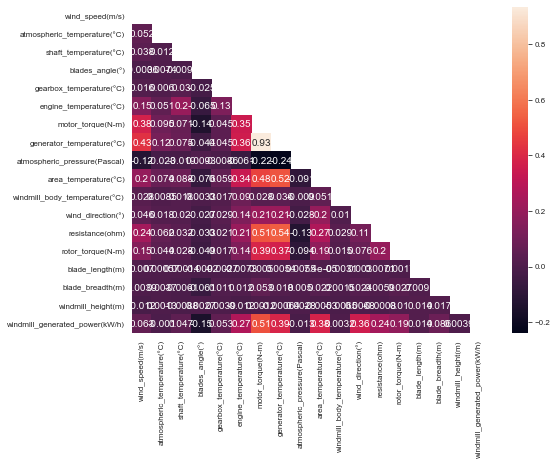

In [19]:
plot_correlation(data=df)

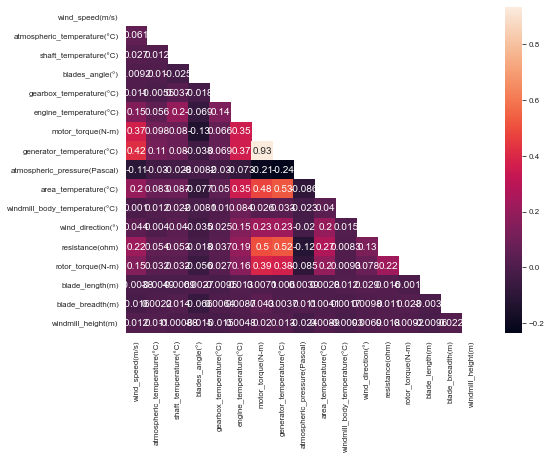

In [20]:
plot_correlation(data=df_test)

In [21]:
# plot sample skewed feature
def plot_skewed_feature(data):
    plt.figure(figsize=(10,4))
    sns.distplot(data[targetFeature])
    plt.show()

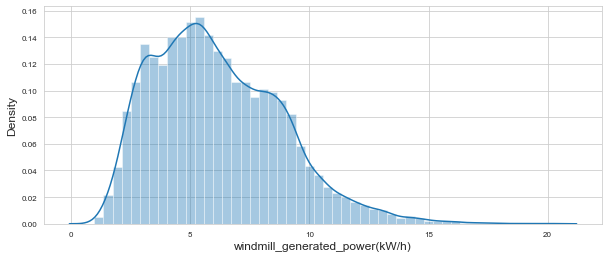

In [22]:
plot_skewed_feature(data=df)

In [23]:
skewed_features = cont_features.apply(lambda x: x.skew()).sort_values(ascending=False)
skewed_features

gearbox_temperature(°C)           0.89
windmill_generated_power(kW/h)    0.69
wind_direction(°)                 0.17
atmospheric_pressure(Pascal)      0.06
motor_torque(N-m)                 0.03
wind_speed(m/s)                  -0.06
windmill_height(m)               -0.11
generator_temperature(°C)        -0.19
blade_breadth(m)                 -0.19
area_temperature(°C)             -0.63
blades_angle(°)                  -0.65
resistance(ohm)                  -0.70
rotor_torque(N-m)                -1.03
atmospheric_temperature(°C)      -1.67
windmill_body_temperature(°C)    -2.24
shaft_temperature(°C)            -2.53
engine_temperature(°C)           -3.94
blade_length(m)                  -8.61
dtype: float64

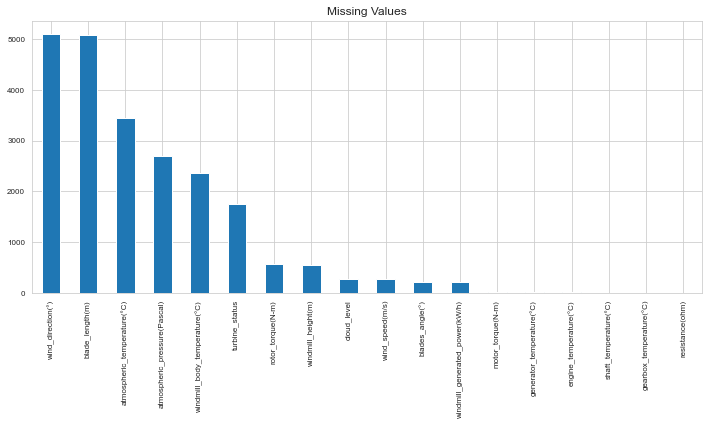

In [24]:
# plot missing values

def calc_missing(data):
    missing = data.isna().sum().sort_values(ascending=False)
    missing = missing[missing != 0]
    missing_perc = missing/data.shape[0]*100
    return missing, missing_perc

if df.isna().any().sum()>0:
    missing, missing_perc = calc_missing(data=df)
    missing.plot(kind='bar',figsize=(12,5))
    plt.title('Missing Values')
    plt.show()
else:
    print("No Missing Values")

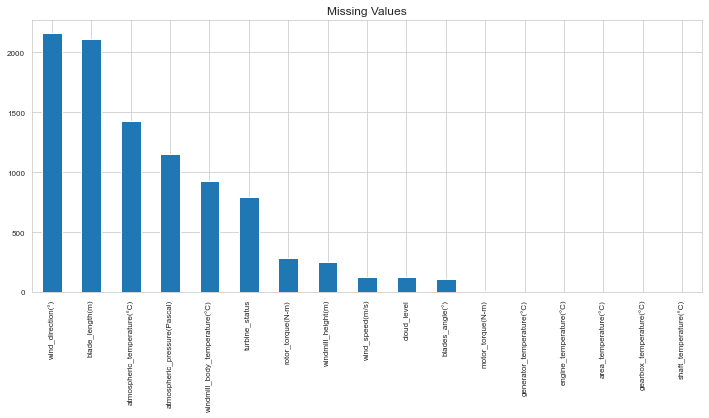

In [25]:
if df_test.isna().any().sum()>0:
    missing, missing_perc = calc_missing(data=df_test)
    missing.plot(kind='bar',figsize=(12,5))
    plt.title('Missing Values')
    plt.show()
else:
    print("No Missing Values")

In [26]:
# remove all columns having no values
df.dropna(axis=1, how="all", inplace=True)
df.dropna(axis=0, how="all", inplace=True)
datasetShape(df)

The dataframe has 28200 rows and 22 columns.


In [27]:
df.describe()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
count,27927.00,24750.00,28198.00,27984.00,28199.00,28188.00,28176.00,28188.00,25493.00,28200.00,25837.00,23097.00,28199.00,27628.00,23107.00,28200.00,27657.00,27993.00
mean,69.04,0.38,40.09,-9.65,41.03,42.61,1710.82,65.03,53185.06,32.74,20.80,306.89,1575.56,25.85,2.25,0.40,25.89,6.13
std,76.28,44.28,27.20,47.92,43.66,6.12,827.21,19.82,187503.62,7.70,54.36,134.06,483.33,32.42,11.28,0.06,7.77,2.70
min,-496.21,-99.00,-99.00,-146.26,-244.97,3.17,500.00,33.89,-1188624.13,-30.00,-999.00,0.00,-1005.22,-136.73,-99.00,0.20,-30.30,0.96
25%,20.88,7.95,41.63,-1.20,40.56,41.91,870.34,41.20,16794.92,27.31,40.45,238.63,1268.13,13.72,2.54,0.35,24.45,4.06
50%,93.30,16.10,43.69,-0.50,43.22,43.53,2031.85,70.73,18191.13,32.61,42.79,271.43,1678.24,32.98,3.45,0.40,25.96,5.76
75%,95.27,23.69,45.67,5.50,45.88,45.17,2462.59,78.95,118113.29,38.23,44.49,404.15,1829.05,41.55,4.36,0.45,27.48,7.95
max,601.46,80.22,169.82,165.93,999.00,50.00,3000.00,100.00,1272551.90,55.00,323.00,569.97,4693.48,236.88,18.21,0.50,78.35,20.18


## Comparing train and test data And Outlier Detection

In [28]:
# function to create histogram, Q-Q plot and boxplot

def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 5, 1)
    sns.histplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 5, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('Variable quantiles')

    # boxplot
    plt.subplot(1, 5, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')
    
    plt.show()

In [29]:
def comparing_train_and_test_feature(df,df_test,col):
    fig = plt.figure(figsize=(10,8))
    ax0 = fig.add_subplot(1,2,1)
    ax1 = fig.add_subplot(1,2,2)
    df[col].plot(kind='kde',ax=ax0)
    df_test[col].plot(kind='kde',ax=ax1)
    ax0.set_xlabel(col)
    ax1.set_xlabel(col)
    ax0.set_title("Density plot of " + str(col) + " of training set")
    ax1.set_title("Density plot of " + str(col) + " of testing set")
    plt.show()

__wind_speed(m/s)__

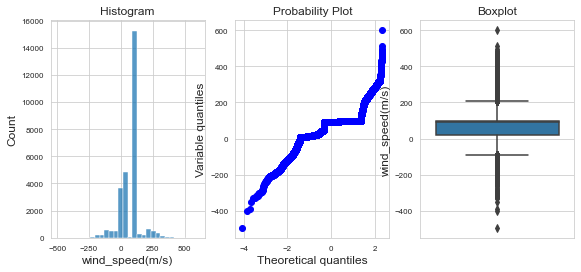

In [30]:
diagnostic_plots(df, 'wind_speed(m/s)')

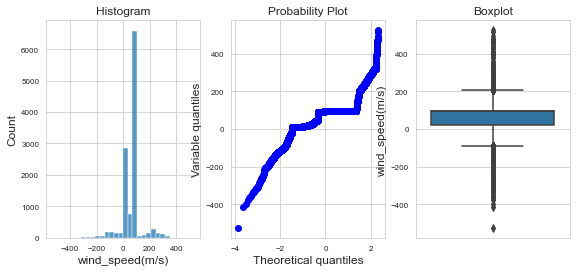

In [31]:
diagnostic_plots(df_test, 'wind_speed(m/s)')

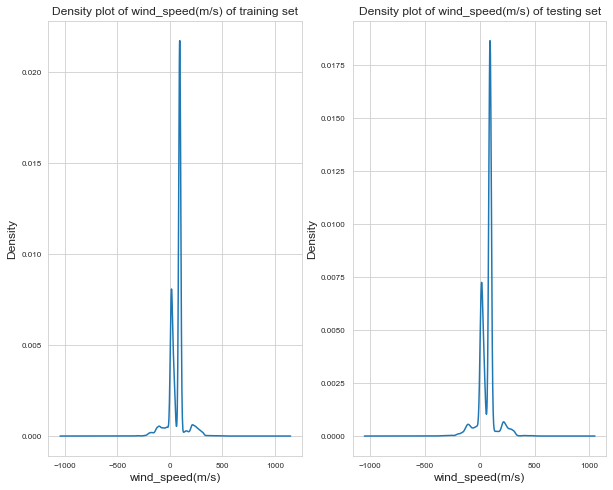

In [32]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'wind_speed(m/s)')
## Distribution of Feature wind_speed(m/s) of training and testing dataset are very similar

<AxesSubplot:xlabel='wind_speed(m/s)', ylabel='windmill_generated_power(kW/h)'>

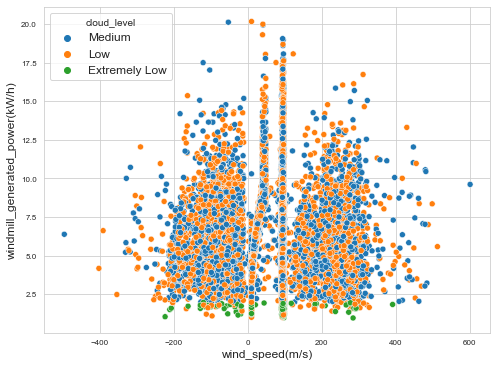

In [33]:
sns.scatterplot(x='wind_speed(m/s)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__atmospheric_temperature(°C)__

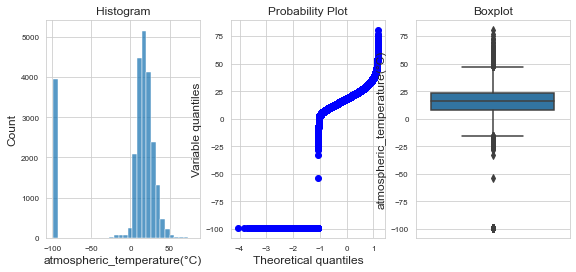

In [34]:
diagnostic_plots(df, 'atmospheric_temperature(°C)')

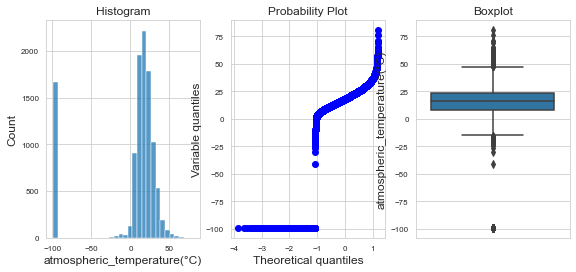

In [35]:
diagnostic_plots(df_test, 'atmospheric_temperature(°C)')

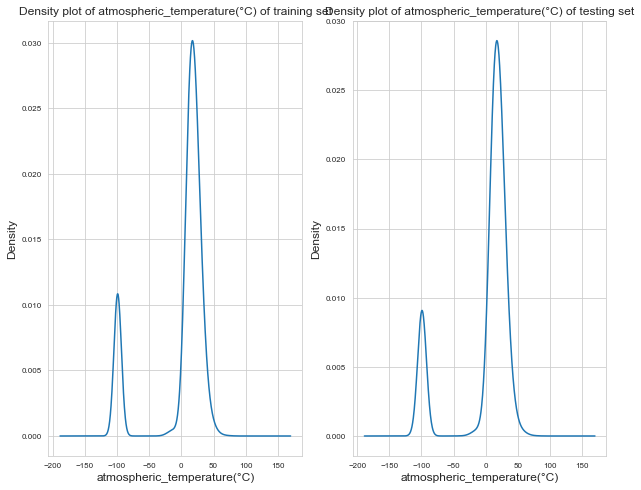

In [36]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'atmospheric_temperature(°C)')
## Distribution of Feature "atmospheric_temperature(°C)" of training and testing dataset is very similar

<AxesSubplot:xlabel='atmospheric_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

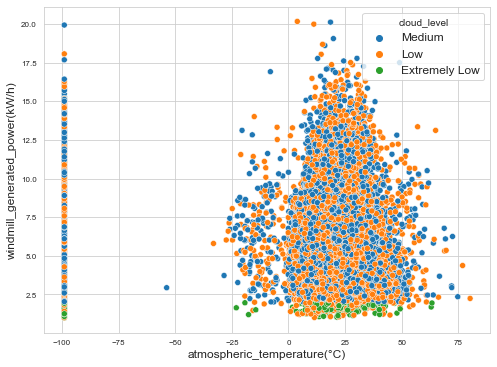

In [37]:
sns.scatterplot(x='atmospheric_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__shaft_temperature(°C)__

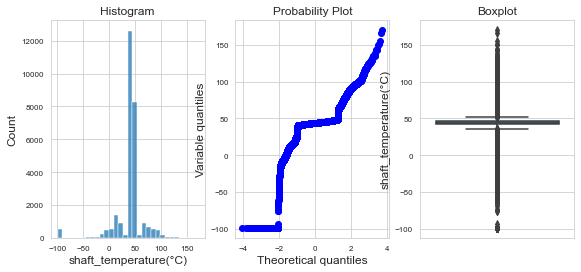

In [38]:
diagnostic_plots(df, 'shaft_temperature(°C)')

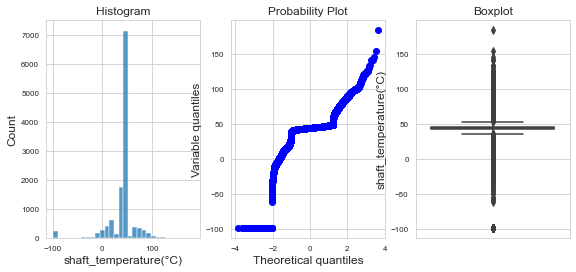

In [39]:
diagnostic_plots(df_test, 'shaft_temperature(°C)')

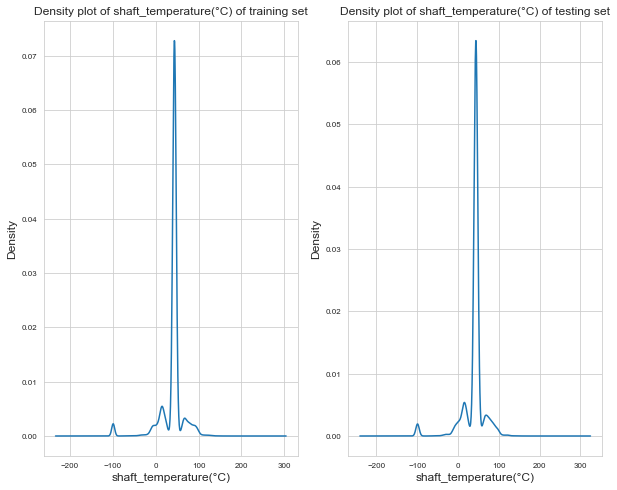

In [40]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'shaft_temperature(°C)')
## Distribution of Feature "shaft_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='shaft_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

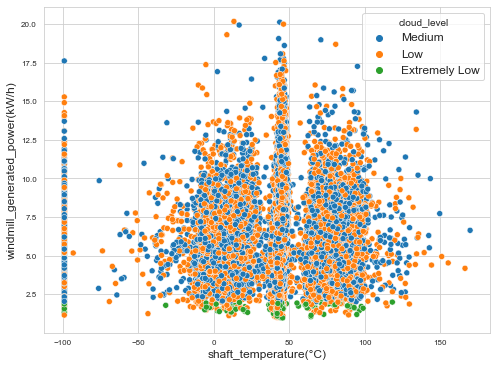

In [41]:
sns.scatterplot(x='shaft_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

<AxesSubplot:xlabel='shaft_temperature(°C)', ylabel='wind_speed(m/s)'>

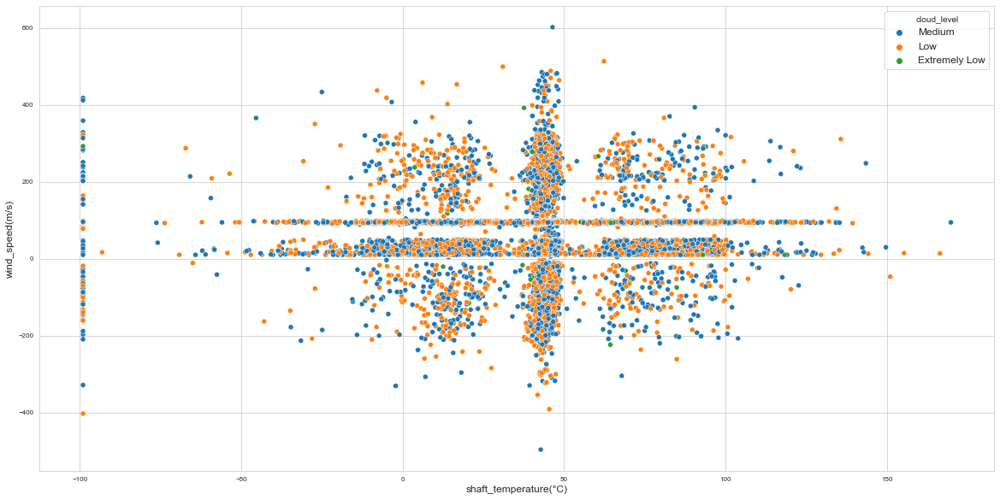

In [42]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='shaft_temperature(°C)',y='wind_speed(m/s)',hue='cloud_level',data=df)

__blades_angle(°)__

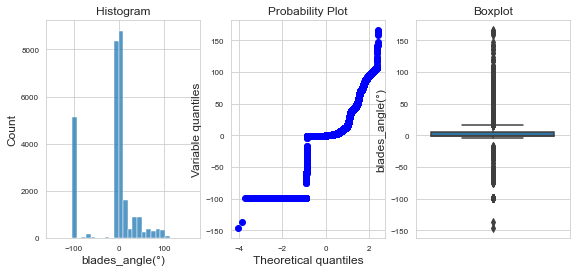

In [43]:
diagnostic_plots(df, 'blades_angle(°)')

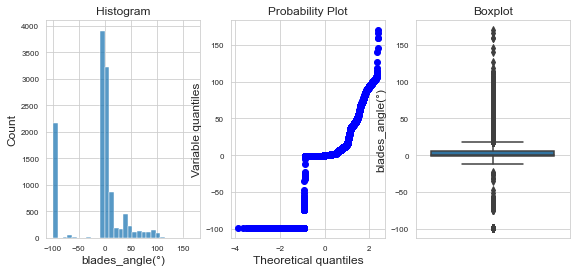

In [44]:
diagnostic_plots(df_test, 'blades_angle(°)')

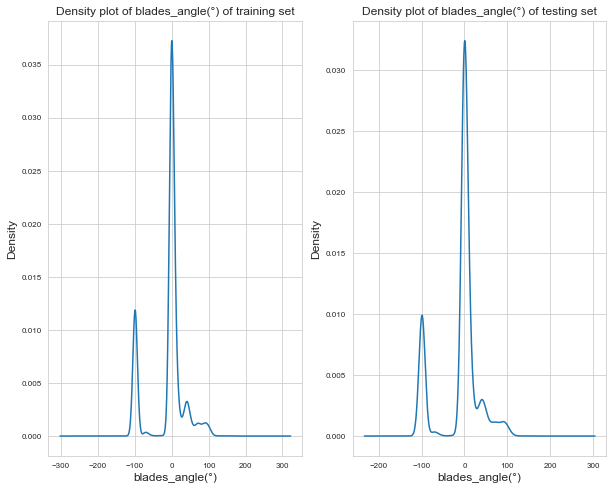

In [45]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blades_angle(°)')
## Distribution of Feature "blades_angle(°)" of training and testing dataset are almost same

<AxesSubplot:xlabel='blades_angle(°)', ylabel='windmill_generated_power(kW/h)'>

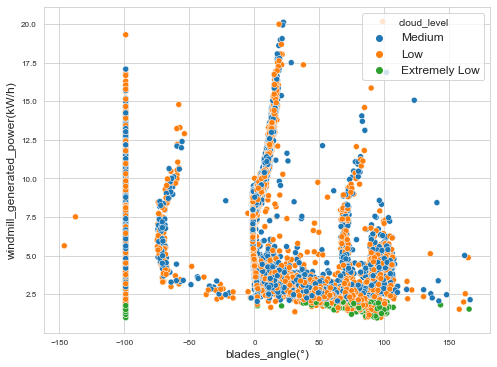

In [46]:
sns.scatterplot(x='blades_angle(°)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__gearbox_temperature(°C)__

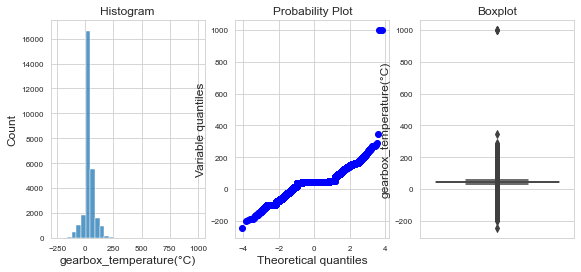

In [47]:
diagnostic_plots(df, 'gearbox_temperature(°C)')

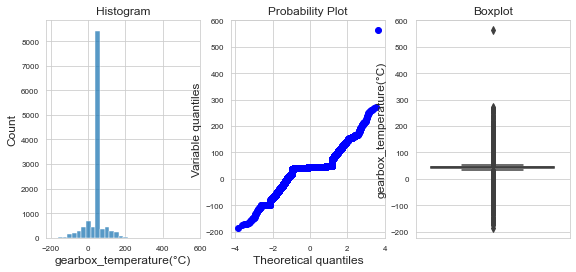

In [48]:
diagnostic_plots(df_test, 'gearbox_temperature(°C)')

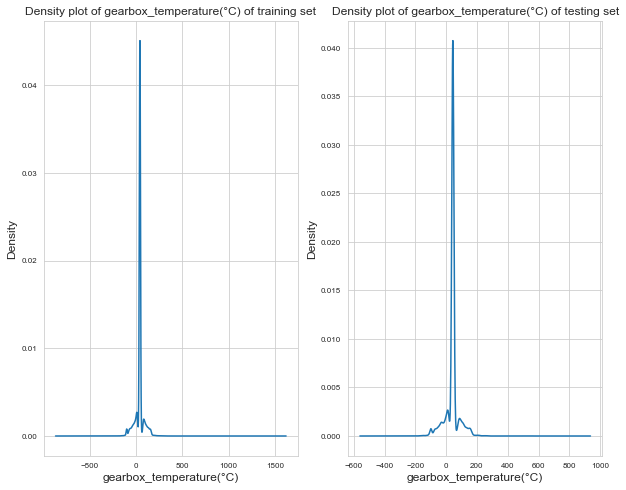

In [49]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'gearbox_temperature(°C)')
## Distribution of Feature "gearbox_temperature(°C)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='gearbox_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

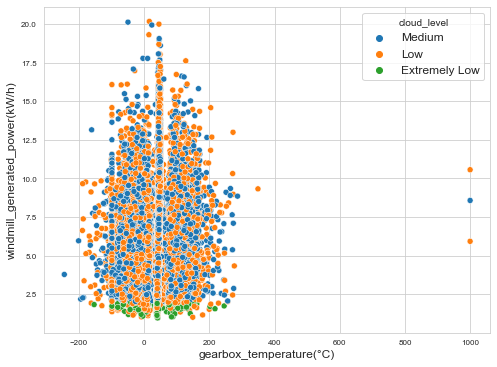

In [50]:
sns.scatterplot(x='gearbox_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__engine_temperature(°C)__

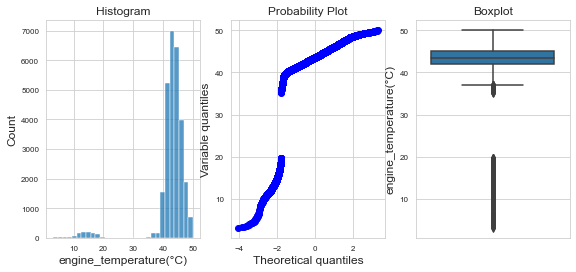

In [51]:
diagnostic_plots(df, 'engine_temperature(°C)')

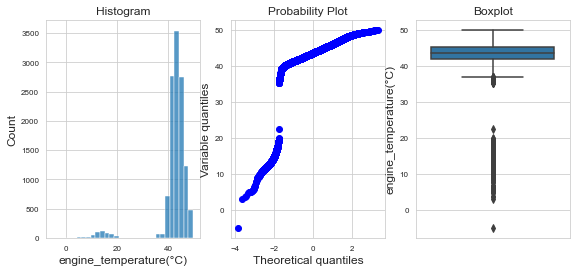

In [52]:
diagnostic_plots(df_test, 'engine_temperature(°C)')

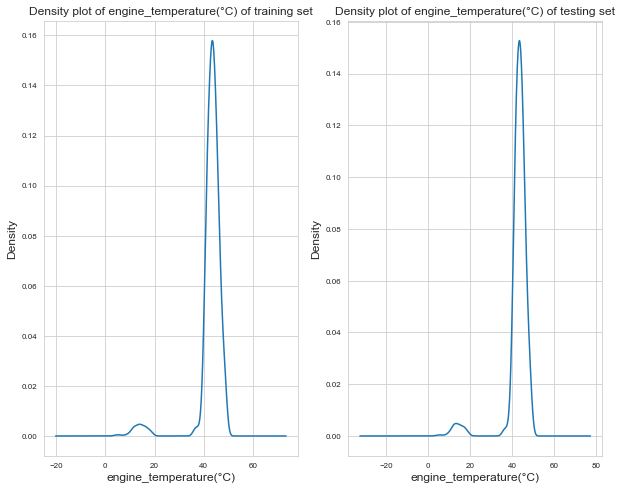

In [53]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'engine_temperature(°C)')
## Distribution of Feature "engine_temperature(°C)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='engine_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

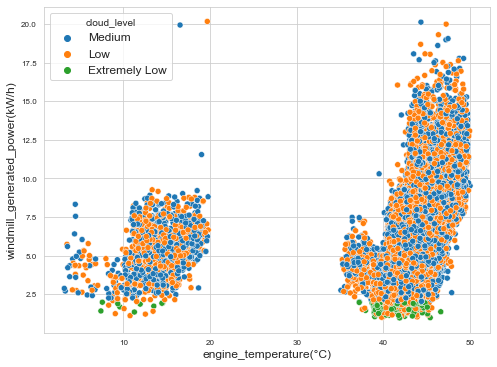

In [54]:
sns.scatterplot(x='engine_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

<AxesSubplot:xlabel='engine_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

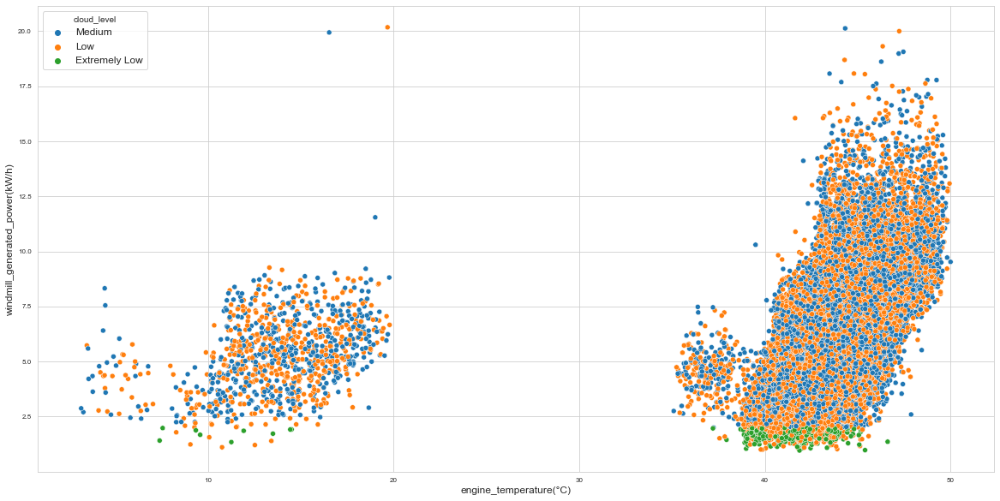

In [55]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='engine_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__motor_torque(N-m)__

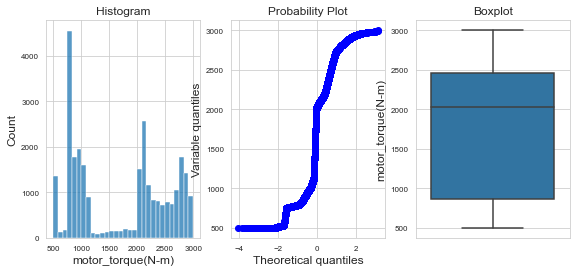

In [56]:
diagnostic_plots(df, 'motor_torque(N-m)')

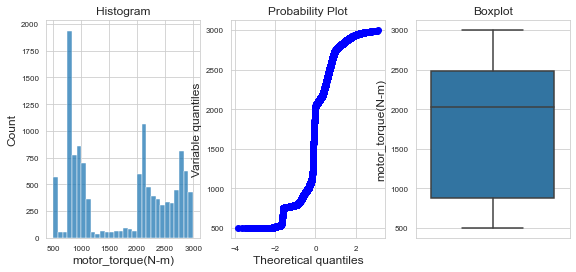

In [57]:
diagnostic_plots(df_test, 'motor_torque(N-m)')

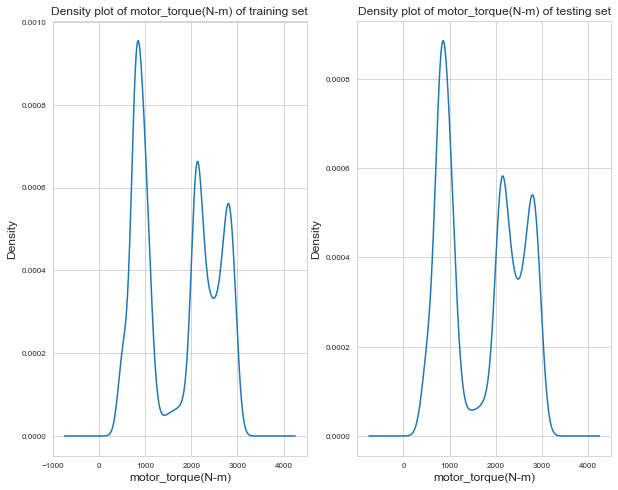

In [58]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'motor_torque(N-m)')
## Distribution of Feature "motor_torque(N-m)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='motor_torque(N-m)', ylabel='windmill_generated_power(kW/h)'>

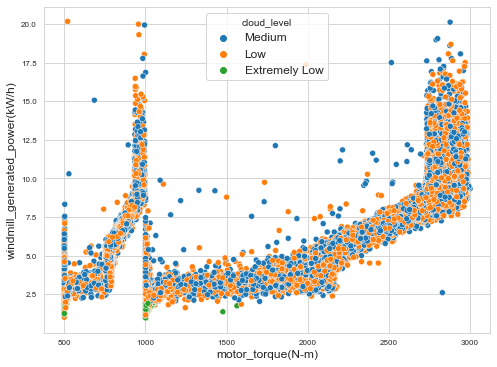

In [59]:
sns.scatterplot(x='motor_torque(N-m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__generator_temperature(°C)__

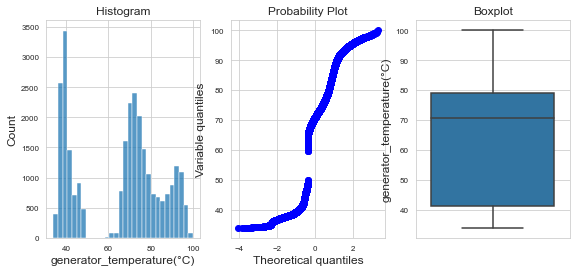

In [60]:
diagnostic_plots(df, 'generator_temperature(°C)')

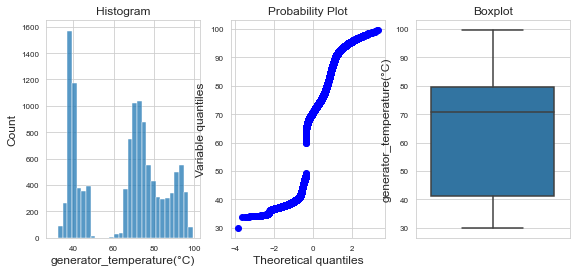

In [61]:
diagnostic_plots(df_test, 'generator_temperature(°C)')

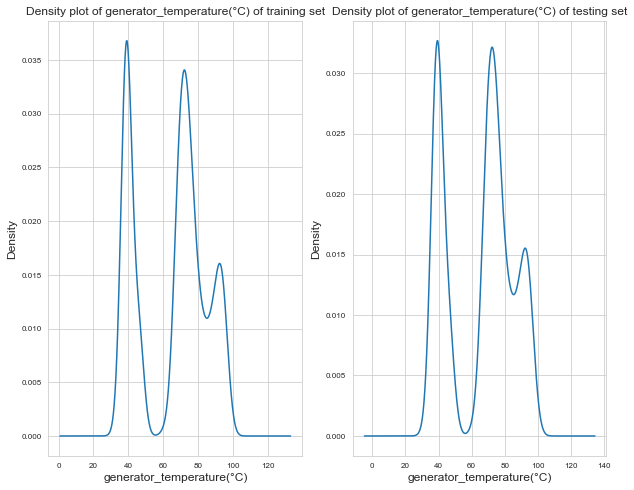

In [62]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'generator_temperature(°C)')
## Distribution of Feature "generator_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='generator_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

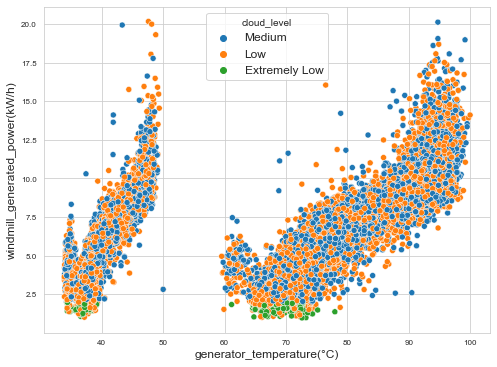

In [63]:
sns.scatterplot(x='generator_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__atmospheric_pressure(Pascal)__

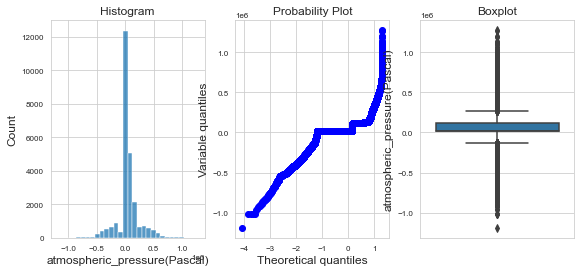

In [64]:
diagnostic_plots(df, 'atmospheric_pressure(Pascal)')

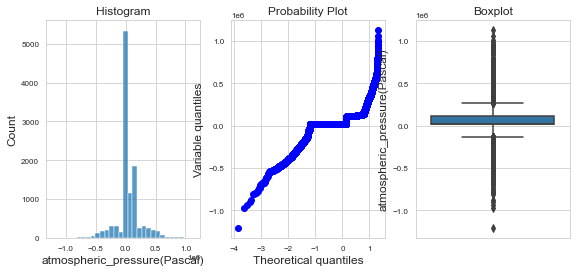

In [65]:
diagnostic_plots(df_test, 'atmospheric_pressure(Pascal)')

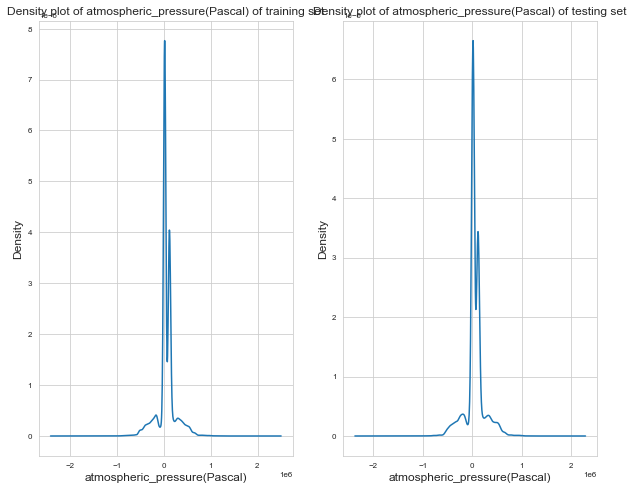

In [66]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'atmospheric_pressure(Pascal)')
## Distribution of Feature "atmospheric_pressure(Pascal)" of training and testing dataset are almost same

<AxesSubplot:xlabel='atmospheric_pressure(Pascal)', ylabel='windmill_generated_power(kW/h)'>

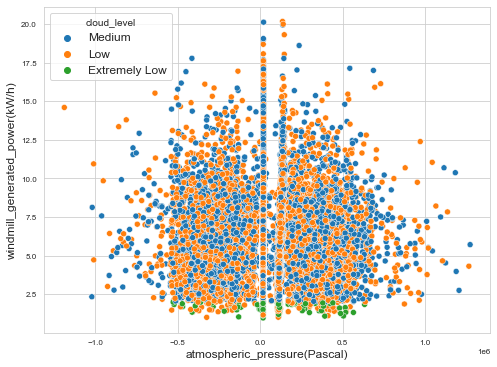

In [67]:
sns.scatterplot(x='atmospheric_pressure(Pascal)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__area_temperature(°C)__

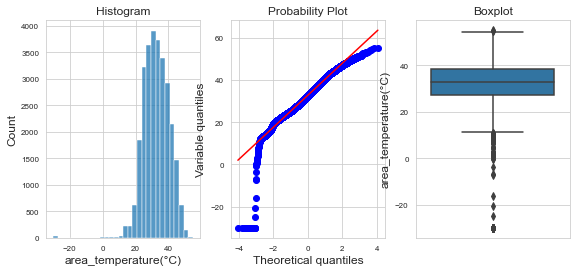

In [68]:
diagnostic_plots(df, 'area_temperature(°C)')

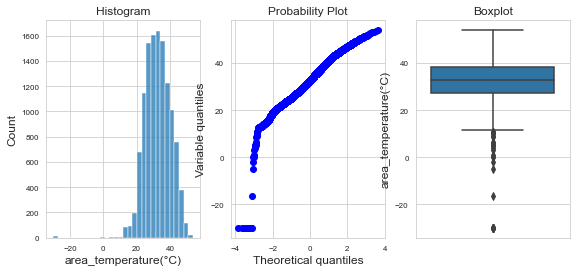

In [69]:
diagnostic_plots(df_test, 'area_temperature(°C)')

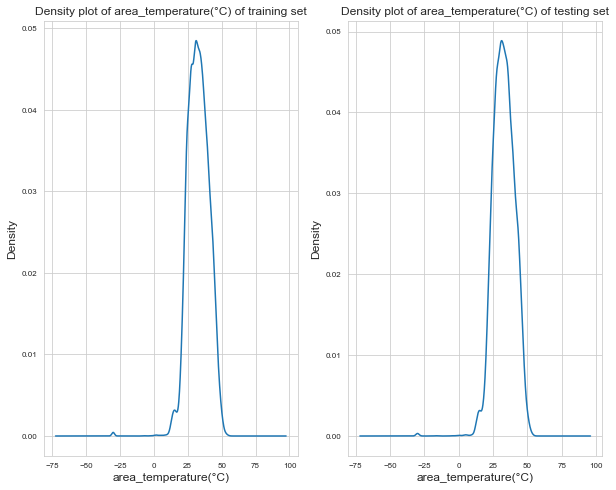

In [70]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'area_temperature(°C)')
## Distribution of Feature "area_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='area_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

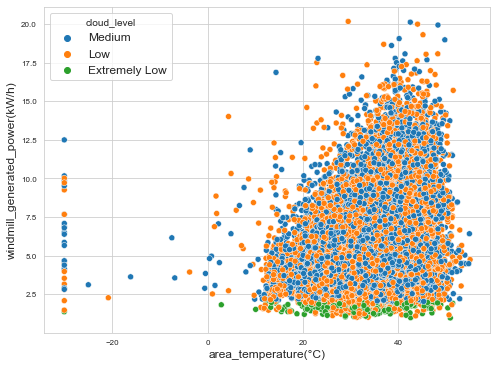

In [71]:
sns.scatterplot(x='area_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

<AxesSubplot:xlabel='area_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

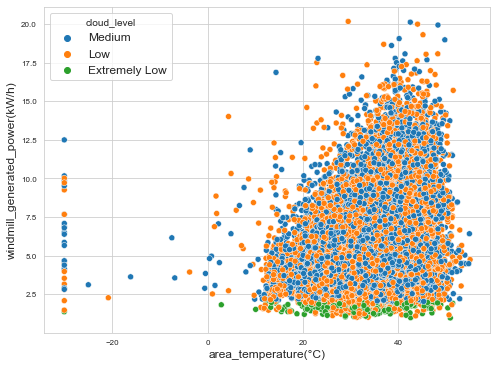

In [72]:
sns.scatterplot(x='area_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__windmill_body_temperature(°C)__

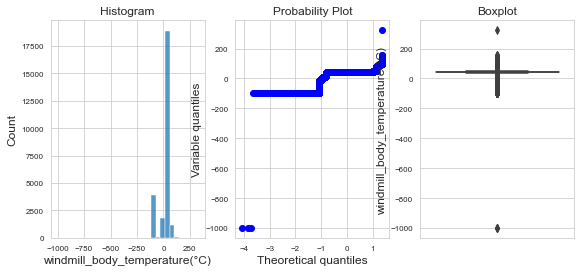

In [73]:
diagnostic_plots(df, 'windmill_body_temperature(°C)')

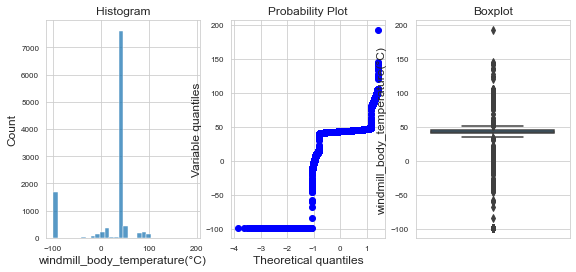

In [74]:
diagnostic_plots(df_test, 'windmill_body_temperature(°C)')

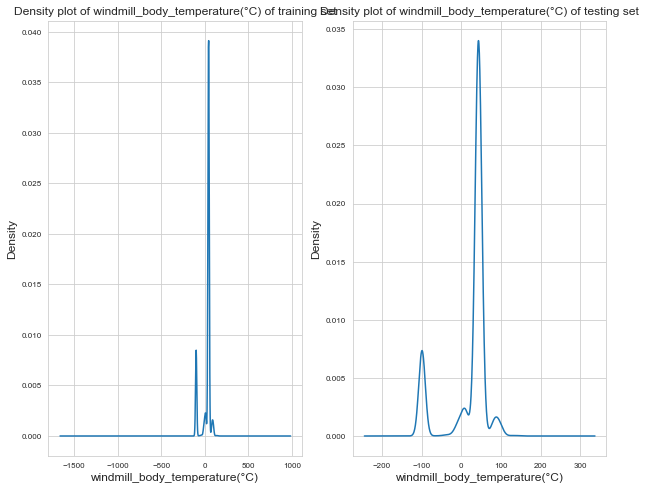

In [75]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'windmill_body_temperature(°C)')
## Distribution of Feature "windmill_body_temperature(°C)" of training and testing dataset is little bit different
## as density plot of windmill_body_temperature(°C) in testing dataset is broader than in training set

<AxesSubplot:xlabel='windmill_body_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

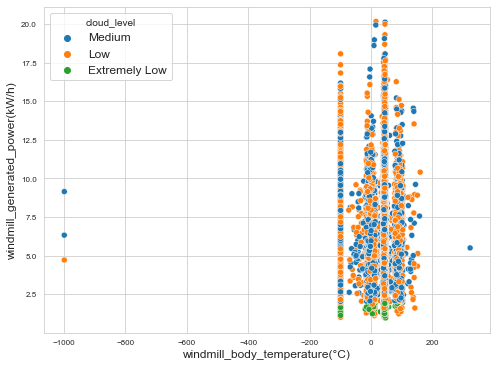

In [76]:
sns.scatterplot(x='windmill_body_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__wind_direction(°)__

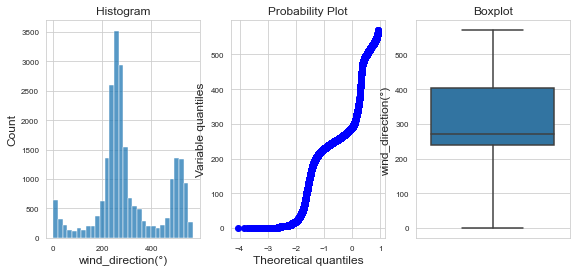

In [77]:
diagnostic_plots(df, 'wind_direction(°)')

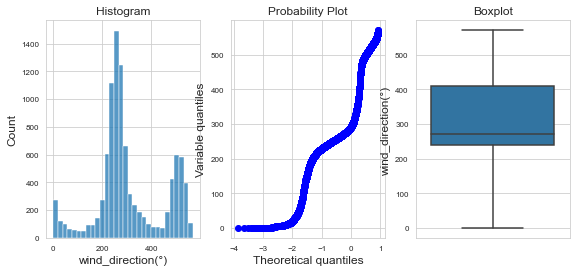

In [78]:
diagnostic_plots(df_test, 'wind_direction(°)')

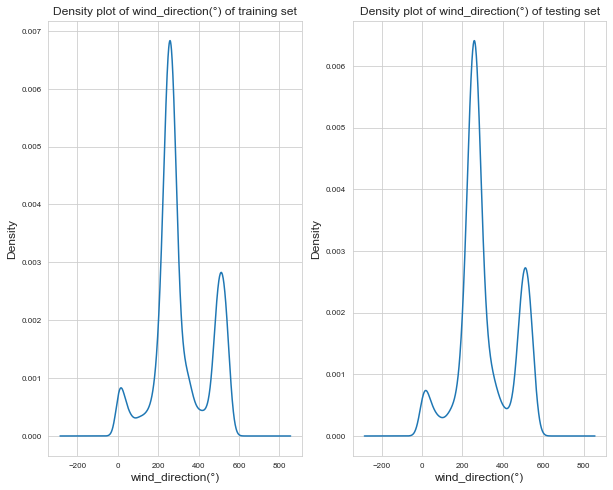

In [79]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'wind_direction(°)')
## Distribution of Feature "wind_direction(°)" of training and testing dataset is almost same

<AxesSubplot:xlabel='wind_direction(°)', ylabel='windmill_generated_power(kW/h)'>

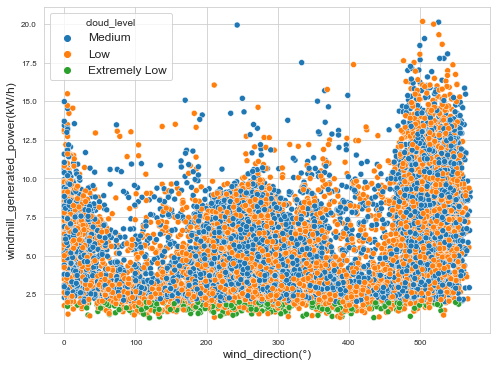

In [80]:
sns.scatterplot(x='wind_direction(°)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__resistance(ohm)__

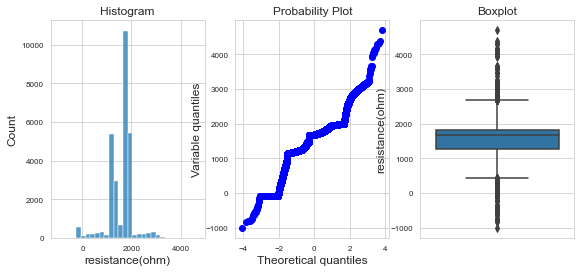

In [81]:
diagnostic_plots(df, 'resistance(ohm)')

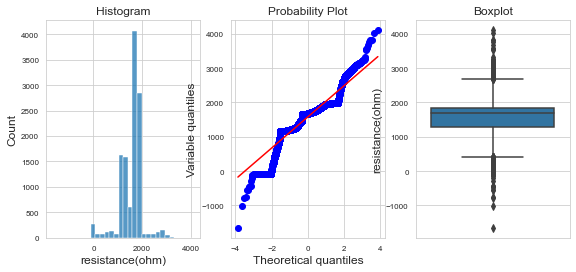

In [82]:
diagnostic_plots(df_test, 'resistance(ohm)')

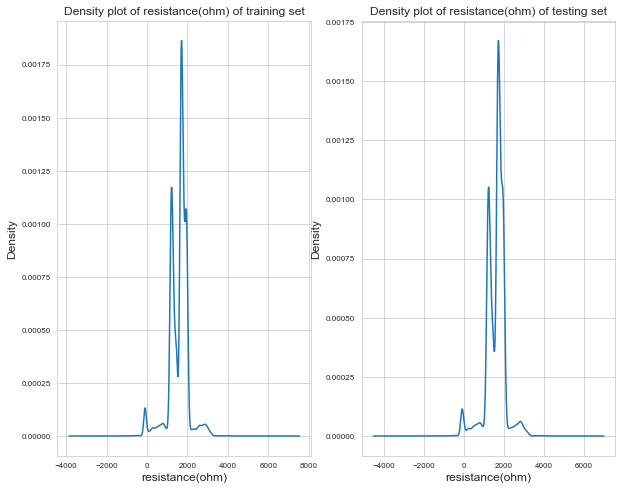

In [83]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'resistance(ohm)')
## Distribution of Feature "resistance(ohm)" of training and testing dataset is almost same

<AxesSubplot:xlabel='resistance(ohm)', ylabel='windmill_generated_power(kW/h)'>

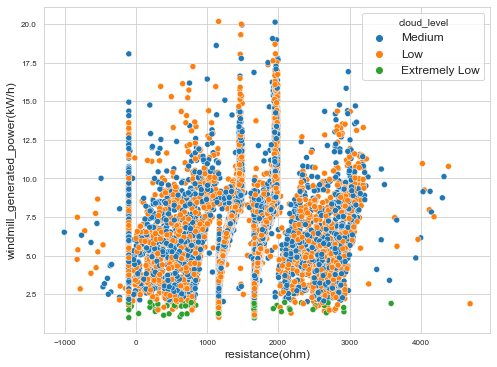

In [84]:
sns.scatterplot(x='resistance(ohm)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__rotor_torque(N-m)__

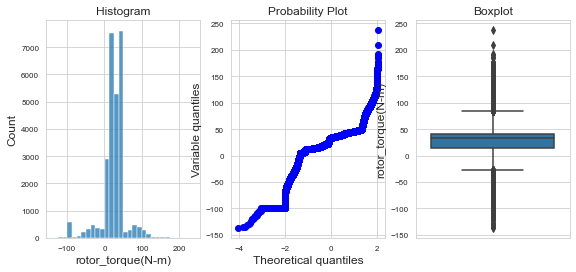

In [85]:
diagnostic_plots(df, 'rotor_torque(N-m)')

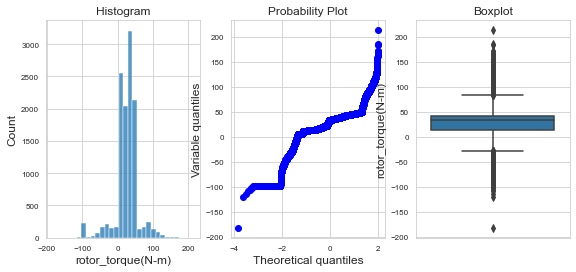

In [86]:
diagnostic_plots(df_test, 'rotor_torque(N-m)')

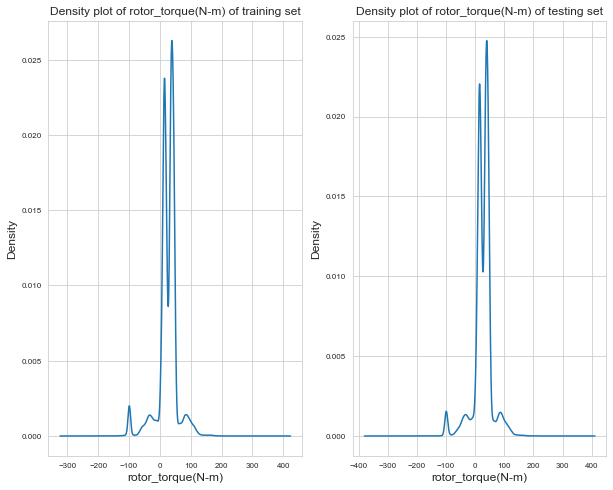

In [87]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'rotor_torque(N-m)')
## Distribution of Feature "rotor_torque(N-m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='rotor_torque(N-m)', ylabel='windmill_generated_power(kW/h)'>

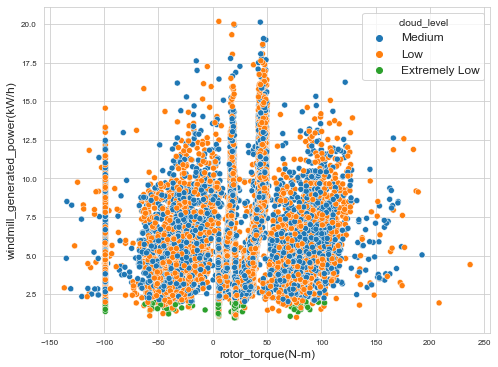

In [88]:
sns.scatterplot(x='rotor_torque(N-m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__blade_length(m)__

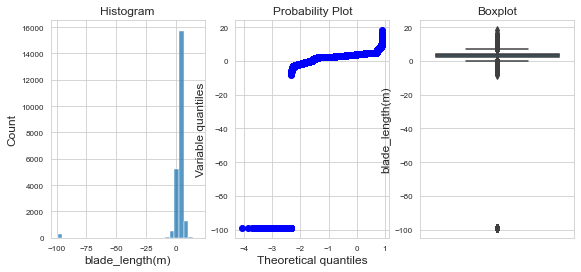

In [89]:
diagnostic_plots(df, 'blade_length(m)')

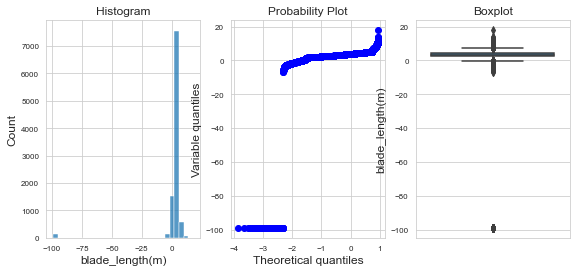

In [90]:
diagnostic_plots(df_test, 'blade_length(m)')

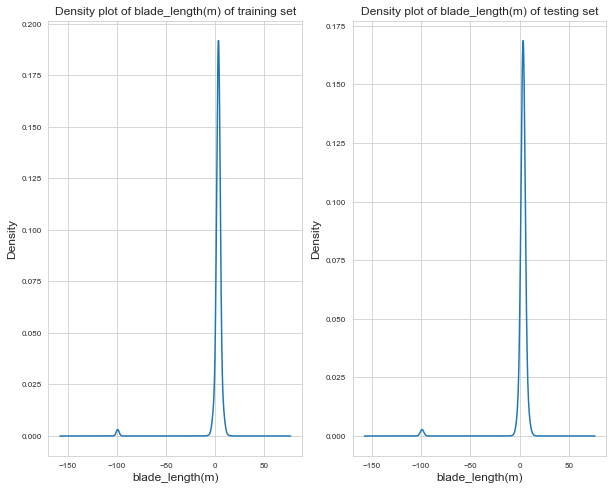

In [91]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blade_length(m)')
## Distribution of Feature "blade_length(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='blade_length(m)', ylabel='windmill_generated_power(kW/h)'>

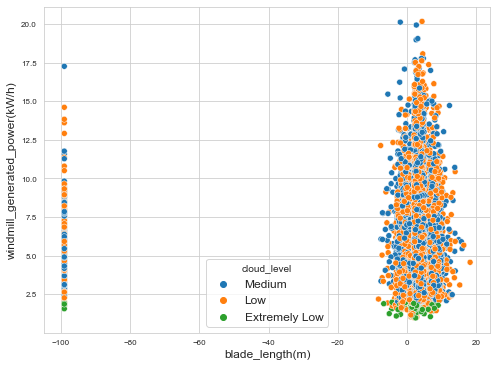

In [92]:
sns.scatterplot(x='blade_length(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

<AxesSubplot:xlabel='blade_length(m)', ylabel='windmill_generated_power(kW/h)'>

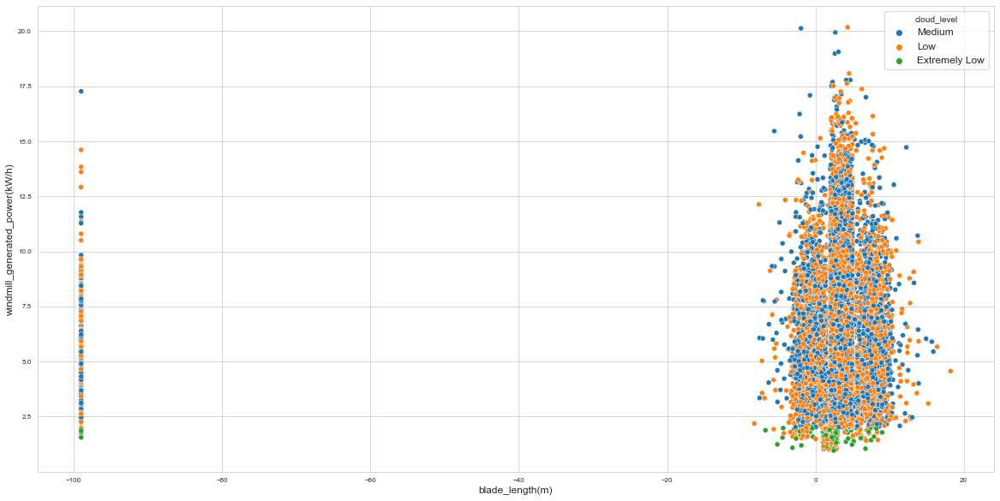

In [93]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='blade_length(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__blade_breadth(m)__

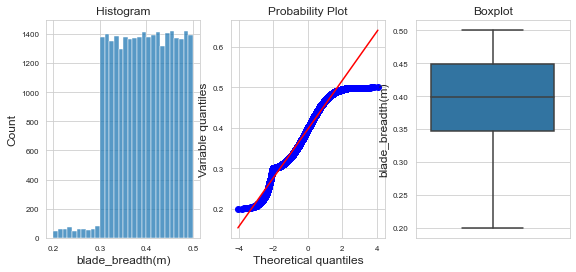

In [94]:
diagnostic_plots(df, 'blade_breadth(m)')

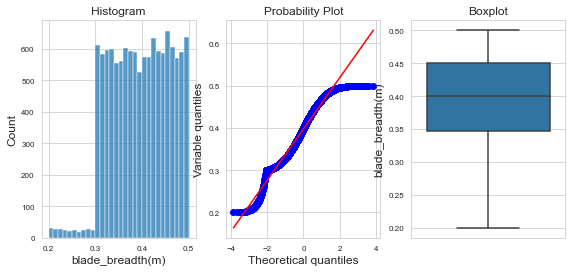

In [95]:
diagnostic_plots(df_test, 'blade_breadth(m)')

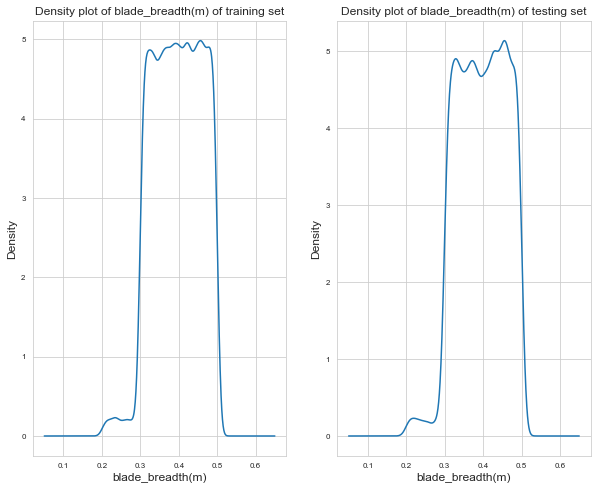

In [96]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blade_breadth(m)')
## Distribution of Feature "blade_breadth(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='blade_breadth(m)', ylabel='windmill_generated_power(kW/h)'>

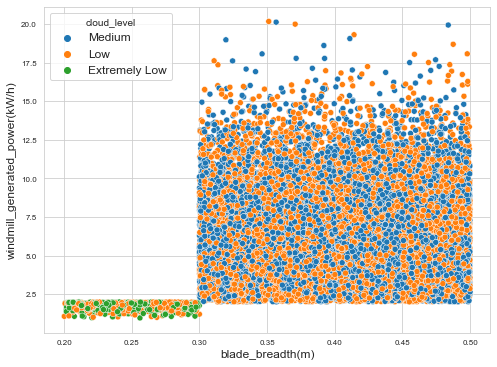

In [97]:
sns.scatterplot(x='blade_breadth(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

From the above density plot of feature "blade_breadth(m)", we found that the distribution of "blade_breadth(m)" is almost same in training and testing dataset, so we are not changing anything in it.

__windmill_height(m)__

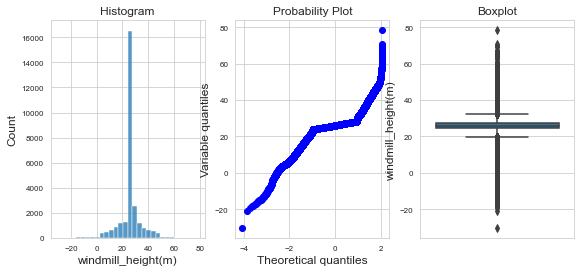

In [98]:
diagnostic_plots(df, 'windmill_height(m)')

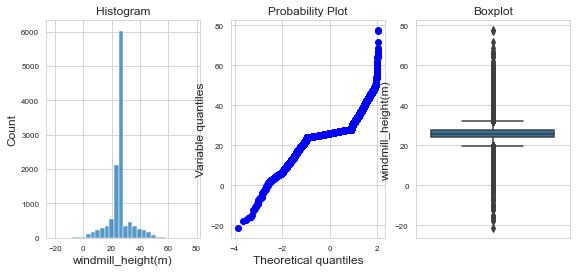

In [99]:
diagnostic_plots(df_test, 'windmill_height(m)')

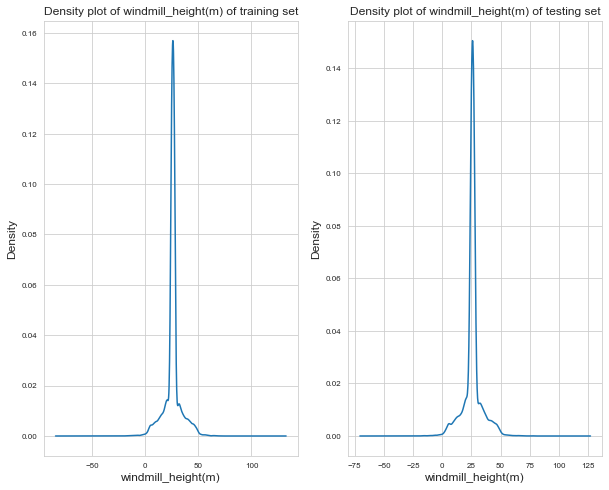

In [100]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'windmill_height(m)')
## Distribution of Feature "windmill_height(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='windmill_height(m)', ylabel='windmill_generated_power(kW/h)'>

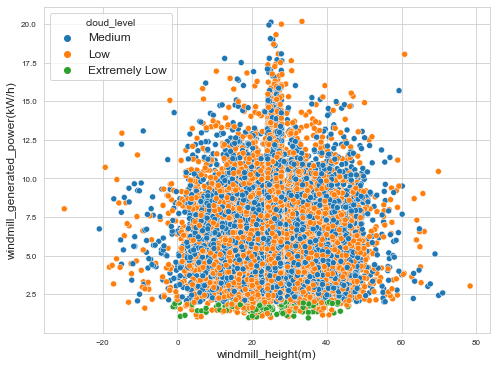

In [101]:
sns.scatterplot(x='windmill_height(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [102]:
def fillNan(df, col, value):
    df[col].fillna(value, inplace=True)

In [103]:
fillNan(df, 'atmospheric_pressure(Pascal)', df['atmospheric_pressure(Pascal)'].mean())
fillNan(df_test, 'atmospheric_pressure(Pascal)', df['atmospheric_pressure(Pascal)'].mean())
df['atmospheric_pressure(Pascal)'].isna().any()

False

In [104]:
fillNan(df, 'motor_torque(N-m)', df['motor_torque(N-m)'].mean())
fillNan(df_test, 'motor_torque(N-m)', df['motor_torque(N-m)'].mean())
df['motor_torque(N-m)'].isna().any()

False

In [105]:
fillNan(df, 'wind_speed(m/s)', df['wind_speed(m/s)'].mean())
fillNan(df_test, 'wind_speed(m/s)', df['wind_speed(m/s)'].mean())
df['wind_speed(m/s)'].isna().any()

False

In [106]:
fillNan(df, 'windmill_height(m)', df['windmill_height(m)'].mean())
fillNan(df_test, 'windmill_height(m)', df['windmill_height(m)'].mean())
df['windmill_height(m)'].isna().any()

False

In [107]:
fillNan(df, 'wind_direction(°)', df['wind_direction(°)'].mean())
fillNan(df_test, 'wind_direction(°)', df['wind_direction(°)'].mean())
df['wind_direction(°)'].isna().any()

False

In [108]:
fillNan(df, 'generator_temperature(°C)', df['generator_temperature(°C)'].mean())
fillNan(df_test, 'generator_temperature(°C)', df['generator_temperature(°C)'].mean())
df['generator_temperature(°C)'].isna().any()

False

In [109]:
fillNan(df, "blade_breadth(m)", df["blade_breadth(m)"].mean())
fillNan(df_test, "blade_breadth(m)", df["blade_breadth(m)"].mean())
df["blade_breadth(m)"].isna().any()

False

In [110]:
fillNan(df, 'blade_length(m)', df['blade_length(m)'].mean())
fillNan(df_test, 'blade_length(m)', df['blade_length(m)'].mean())
df['blade_length(m)'].isna().any()

False

In [111]:
fillNan(df, 'atmospheric_temperature(°C)', df['atmospheric_temperature(°C)'].mean())
fillNan(df_test, 'atmospheric_temperature(°C)', df['atmospheric_temperature(°C)'].mean())
df['atmospheric_temperature(°C)'].isna().any()

False

In [112]:
fillNan(df, 'windmill_body_temperature(°C)', df['windmill_body_temperature(°C)'].mean())
fillNan(df_test, 'windmill_body_temperature(°C)', df['windmill_body_temperature(°C)'].mean())
df['windmill_body_temperature(°C)'].isna().any()

False

In [113]:
fillNan(df, 'blades_angle(°)', df['blades_angle(°)'].mean())
fillNan(df_test, 'blades_angle(°)', df['blades_angle(°)'].mean())
df['blades_angle(°)'].isna().any()

False

In [114]:
fillNan(df, 'engine_temperature(°C)', df['engine_temperature(°C)'].mean())
fillNan(df_test, 'engine_temperature(°C)', df['engine_temperature(°C)'].mean())
df['engine_temperature(°C)'].isna().any()

False

In [115]:
fillNan(df, 'shaft_temperature(°C)', df['shaft_temperature(°C)'].mean())
fillNan(df_test, 'shaft_temperature(°C)', df['shaft_temperature(°C)'].mean())
df['shaft_temperature(°C)'].isna().any()

False

In [116]:
fillNan(df, 'gearbox_temperature(°C)', df['gearbox_temperature(°C)'].mean())
fillNan(df_test, 'gearbox_temperature(°C)', df['gearbox_temperature(°C)'].mean())
df['gearbox_temperature(°C)'].isna().any()

False

In [117]:
fillNan(df, 'resistance(ohm)', df['resistance(ohm)'].mean())
fillNan(df_test, 'resistance(ohm)', df['resistance(ohm)'].mean())
df['resistance(ohm)'].isna().any()

False

In [118]:
fillNan(df, 'rotor_torque(N-m)', df['rotor_torque(N-m)'].mean())
fillNan(df_test, 'resistance(ohm)', df['rotor_torque(N-m)'].mean())
df['rotor_torque(N-m)'].isna().any()

False

In [119]:
fillNan(df, 'turbine_status', df['turbine_status'].mode()[0])
fillNan(df_test, 'turbine_status', df['turbine_status'].mode()[0])
df['turbine_status'].isna().any()

False

In [120]:
fillNan(df, 'cloud_level', df['cloud_level'].mode()[0])
fillNan(df_test, 'cloud_level', df['cloud_level'].mode()[0])
df['cloud_level'].isna().any()

False

In [121]:
fillNan(df, 'windmill_generated_power(kW/h)', df['windmill_generated_power(kW/h)'].median())
df['windmill_generated_power(kW/h)'].isna().any()

False

## Create Dummy Features

In [122]:
cont_features, cat_features = divideFeatures(df)
cat_features

,tracking_id,datetime,turbine_status,cloud_level
0,WM_33725,2019-08-04 14:33:20,BA,Medium
1,WM_698,2018-11-05 10:13:20,A2,Medium
2,WM_39146,2019-09-14 14:03:20,ABC,Medium
3,WM_6757,2018-12-25 15:33:20,ABC,Low
4,WM_21521,2019-05-04 03:13:20,AAA,Medium
...,...,...,...,...
28195,WM_7814,2019-01-02 02:43:20,BB,Medium
28196,WM_32512,2019-07-26 12:53:20,BB,Low
28197,WM_5193,2018-12-12 02:13:20,D,Medium
28198,WM_12173,2019-02-03 19:13:20,BCB,Low


In [123]:
# label encoding
def mapFeature(data, f, data_test=None):
    feat = data[f].unique()
    feat_idx = [x for x in range(len(feat))]

    data[f].replace(feat, feat_idx, inplace=True)
    if data_test is not None:
        data_test[f].replace(feat, feat_idx, inplace=True)

In [124]:
for col in cat_features.columns[2:]:
    mapFeature(df, col, df_test)
df_test.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m)
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,0,0,3.19,0.40,25.57
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,53185.06,29.43,42.73,499.60,1165.11,-35.05,12,0,3.02,0.44,24.37
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,10,0,2.61,0.39,27.65
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,53185.06,23.89,13.50,306.89,1329.74,15.25,11,1,2.87,0.45,24.19
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,12,1,3.55,0.37,4.89


In [125]:
# create dummy features
custom_feat = ['turbine_status']
for feat in cat_features.columns:
    if len(df[feat].unique()) > 2 and feat in custom_feat:
        dummyVars = pd.get_dummies(df[feat], drop_first=True, prefix=feat+"_")
        df = pd.concat([df, dummyVars], axis=1)
        df.drop(feat, axis=1, inplace=True)
datasetShape(df)

df.head()

The dataframe has 28200 rows and 34 columns.


,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13
0,WM_33725,2019-08-04 14:33:20,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,20.80,239.84,2730.31,42.08,0,2.22,0.31,24.28,6.77,0,0,0,0,0,0,0,0,0,0,0,0,0
1,WM_698,2018-11-05 10:13:20,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,20.80,337.94,1780.21,107.89,0,4.21,0.45,27.26,5.97,1,0,0,0,0,0,0,0,0,0,0,0,0
2,WM_39146,2019-09-14 14:03:20,95.48,0.38,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,0,2.72,0.30,27.37,2.87,0,1,0,0,0,0,0,0,0,0,0,0,0
3,WM_6757,2018-12-25 15:33:20,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,1,4.86,0.37,24.29,14.85,0,1,0,0,0,0,0,0,0,0,0,0,0
4,WM_21521,2019-05-04 03:13:20,10.72,0.38,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,0,2.25,0.45,27.97,3.52,0,0,1,0,0,0,0,0,0,0,0,0,0


In [126]:
# create dummy features
custom_feat = ['turbine_status']
for feat in cat_features.columns:
    if len(df_test[feat].unique()) > 2 and feat in custom_feat:
        dummyVars = pd.get_dummies(df_test[feat], drop_first=True, prefix=feat+"_")
        df_test = pd.concat([df_test, dummyVars], axis=1)
        df_test.drop(feat, axis=1, inplace=True)
datasetShape(df_test)

df_test.head()

The dataframe has 12086 rows and 33 columns.


,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,0,3.19,0.40,25.57,0,0,0,0,0,0,0,0,0,0,0,0,0
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,53185.06,29.43,42.73,499.60,1165.11,-35.05,0,3.02,0.44,24.37,0,0,0,0,0,0,0,0,0,0,0,1,0
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,0,2.61,0.39,27.65,0,0,0,0,0,0,0,0,0,1,0,0,0
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,53185.06,23.89,13.50,306.89,1329.74,15.25,1,2.87,0.45,24.19,0,0,0,0,0,0,0,0,0,0,1,0,0
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,1,3.55,0.37,4.89,0,0,0,0,0,0,0,0,0,0,0,1,0


In [127]:
# ## Feature "cloud_level" is categorical with 3 unique values
# df['cloud_level'].replace(['Medium', 'Low', 'Extremely Low'],[2,1,0],inplace=True)
# df_test['cloud_level'].replace(['Medium', 'Low', 'Extremely Low'],[2,1,0],inplace=True)

## Derive Features

In [128]:
df['datetime'] = pd.to_datetime(df['datetime'])
df_test['datetime'] = pd.to_datetime(df_test['datetime'])

df['year'] = df['datetime'].dt.year
df_test['year'] = df_test['datetime'].dt.year

df['month'] = df['datetime'].dt.month
df_test['month'] = df_test['datetime'].dt.month

df['day'] = df['datetime'].dt.day
df_test['day'] = df_test['datetime'].dt.day

df['dayofweek'] = df['datetime'].dt.dayofweek
df_test['dayofweek'] = df_test['datetime'].dt.dayofweek

df['quarter'] = df['datetime'].dt.quarter
df_test['quarter'] = df_test['datetime'].dt.quarter

df['hour'] = df['datetime'].dt.hour
df['min'] = df['datetime'].dt.minute
df['sec'] = df['datetime'].dt.second

df_test['hour'] = df_test['datetime'].dt.hour
df_test['min'] = df_test['datetime'].dt.minute
df_test['sec'] = df_test['datetime'].dt.second

In [129]:
df.drop(['tracking_id', 'datetime'], inplace=True, axis=1)
submission = pd.DataFrame(data=df_test['tracking_id'])
submission['datetime'] = df_test.datetime
df_test.drop(['tracking_id', 'datetime'], inplace=True, axis=1)
df.head()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13,year,month,day,dayofweek,quarter,hour,min,sec
0,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,20.80,239.84,2730.31,42.08,0,2.22,0.31,24.28,6.77,0,0,0,0,0,0,0,0,0,0,0,0,0,2019,8,4,6,3,14,33,20
1,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,20.80,337.94,1780.21,107.89,0,4.21,0.45,27.26,5.97,1,0,0,0,0,0,0,0,0,0,0,0,0,2018,11,5,0,4,10,13,20
2,95.48,0.38,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,0,2.72,0.30,27.37,2.87,0,1,0,0,0,0,0,0,0,0,0,0,0,2019,9,14,5,3,14,3,20
3,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,1,4.86,0.37,24.29,14.85,0,1,0,0,0,0,0,0,0,0,0,0,0,2018,12,25,1,4,15,33,20
4,10.72,0.38,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,0,2.25,0.45,27.97,3.52,0,0,1,0,0,0,0,0,0,0,0,0,0,2019,5,4,5,2,3,13,20


## Data Modeling

In [130]:
# shuffle samples
df_shuffle = df.sample(frac=1, random_state=42).reset_index(drop=True)

df_y = df_shuffle.pop(targetFeature)
df_X = df_shuffle

# split into train dev and test
X_train, X_test, y_train, y_test = train_test_split(df_X, df_y, train_size=0.8, random_state=42)
print(f"Train set has {X_train.shape[0]} records out of {len(df_shuffle)} which is {round(X_train.shape[0]/len(df_shuffle)*100)}%")
print(f"Test set has {X_test.shape[0]} records out of {len(df_shuffle)} which is {round(X_test.shape[0]/len(df_shuffle)*100)}%")

Train set has 22560 records out of 28200 which is 80%
Test set has 5640 records out of 28200 which is 20%


In [131]:
scaler = RobustScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)

# scale test data with transform()
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_train.columns)

# view sample data
X_train.describe()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13,year,month,day,dayofweek,quarter,hour,min,sec
count,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00,22560.00
mean,-0.33,-0.62,-0.91,-1.40,-0.41,-0.27,-0.20,-0.15,0.35,0.01,-0.92,0.20,-0.18,-0.20,-0.47,-0.40,-0.01,0.01,0.07,0.07,0.07,0.06,0.07,0.13,0.07,0.07,0.06,0.07,0.07,0.07,0.07,-0.19,0.04,0.03,-0.02,0.19,-0.03,-0.17,0.00
std,1.03,1.87,6.78,7.24,8.22,1.86,0.52,0.53,1.80,0.71,2.22,1.41,0.87,1.18,0.52,5.24,0.60,2.60,0.25,0.25,0.25,0.25,0.25,0.34,0.25,0.25,0.25,0.25,0.25,0.26,0.25,0.39,0.58,0.58,0.50,0.54,0.58,0.57,0.00
min,-7.95,-5.09,-35.29,-22.06,-54.22,-12.32,-0.97,-0.98,-10.43,-5.73,-44.25,-3.35,-4.81,-6.07,-1.00,-53.49,-1.94,-18.87,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-1.00,-0.83,-0.93,-0.75,-0.50,-1.00,-1.00,0.00
25%,-0.97,-0.62,-0.51,-0.10,-0.50,-0.50,-0.73,-0.78,-0.02,-0.49,-0.92,-0.50,-0.73,-0.64,-1.00,-0.42,-0.50,-0.48,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.50,-0.47,-0.50,-0.50,-0.50,-0.67,0.00
50%,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.03,0.38,0.49,0.90,0.50,0.50,0.27,0.22,0.98,0.51,0.08,0.50,0.27,0.36,0.00,0.58,0.50,0.52,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.53,0.50,0.50,0.50,0.33,0.00
max,6.86,2.97,31.20,25.20,179.81,1.99,0.61,0.78,12.60,2.05,11.92,3.24,5.41,7.51,1.00,7.94,0.98,17.61,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.07,0.75,1.00,0.92,0.67,0.00


### XGBoost Regressor

In [132]:
xgboost = XGBRegressor(n_estimators=500,max_depth=5,booster='gbtree',n_jobs=-1,
                       learning_rate=0.1,reg_lambda=0.01,reg_alpha=0.3,silent=1)
xgboost.fit(X_train, y_train)

# predict
y_train_pred = xgboost.predict(X_train)
y_test_pred = xgboost.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

[04:23:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


0.9882399790724622
0.9575423781619743


### LGBM Regressor

In [133]:
lgbm = lgb.LGBMRegressor(objective='mse', seed=8798, num_threads=1, learning_rate=0.1, 
                               max_depth=5, n_estimators=750, num_leaves=70, reg_alpha=0.001, reg_lambda=0.003)
lgbm.fit(X_train, y_train, verbose=10)

y_train_pred = lgbm.predict(X_train)
y_test_pred = lgbm.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1
0.987706205364204
0.9597270354894629


### CatBoost Regressor

In [134]:
catboost = CatBoostRegressor(logging_level='Silent')
catboost.fit(X_train, y_train)

y_train_pred = catboost.predict(X_train)
y_test_pred = catboost.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

0.979082087574675
0.9598258750310869


### DecisionTree Regressor

In [135]:
# regressor4 = DecisionTreeRegressor(max_depth=100, min_samples_split=45, min_samples_leaf=10)
# regressor4.fit(X_train, y_train)

# y_train_pred = regressor4.predict(X_train)
# y_test_pred = regressor4.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### ExtraTree Regressor

In [136]:
# regressor5 = ExtraTreeRegressor()
# regressor5.fit(X_train, y_train)

# y_train_pred = regressor5.predict(X_train)
# y_test_pred = regressor5.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### RandomForest Regressor

In [137]:
# regressor6 = RandomForestRegressor(n_estimators=500, min_samples_leaf=1, max_depth=20, 
#                                 min_samples_split=3)
# regressor6.fit(X_train, y_train)

# y_train_pred = regressor6.predict(X_train)
# y_test_pred = regressor6.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### AdaBoost Regressor

In [138]:
# regressor7 = AdaBoostRegressor()
# regressor7.fit(X_train, y_train)

# y_train_pred = regressor7.predict(X_train)
# y_test_pred = regressor7.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### ExtraTrees Regressor

In [139]:
# regressor8 = ExtraTreesRegressor(criterion='mse', random_state=0, n_jobs=-1, 
#                                 min_samples_leaf=1, max_depth=20, 
#                                 min_samples_split=3, n_estimators=1000)
# regressor8.fit(X_train, y_train)
# y_train_pred = regressor8.predict(X_train)
# y_test_pred = regressor8.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### GradientBoosting Regressor

In [140]:
gbr = GradientBoostingRegressor(criterion='mse',random_state=0,max_depth=5,
                                     n_estimators=500,min_samples_split=2,min_samples_leaf=2)
gbr.fit(X_train, y_train)

y_train_pred = gbr.predict(X_train)
y_test_pred = gbr.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

0.9872442470592138
0.9597023304386543


## Final Model (Mixed Model)

In [141]:
mixed_model = [ ('XGB', xgboost), ('LGB', lgbm), ('catBoost', catboost)]
regressor = VotingRegressor(estimators=mixed_model)
regressor.fit(X_train, y_train)
yhat = regressor.predict(X_test)
print(r2_score(y_test, yhat))

[04:25:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1
0.961453797636072


In [142]:
regressor = VotingRegressor(estimators=mixed_model)
regressor.fit(df_X, df_y)
pred = regressor.predict(df_test)

[04:26:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1


In [143]:
submission[targetFeature] = pred
submission.to_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\submission4.csv', index=False)

## Custom Model Mixing

In [144]:
# class MixModel(XGBRegressor, lgb.LGBMRegressor, CatBoostRegressor):
#     '''
#     Here we will get a set of models as parameter already trained and 
#     will calculate the mean of the predictions for using each model predictions
#     '''
#     def __init__(self, algs):
#         self.algs = algs

#     # Define clones of parameters models
#     def fit(self, X, y):
#         self.algs_ = [clone(x) for x in self.algs]
        
#         # Train cloned base models
#         for alg in self.algs_:
#             alg.fit(X, y)

#         return self
    
#     # Average predictions of all cloned models
#     def predict(self, X):
#         predictions = np.column_stack([
#             stacked_model.predict(X) for stacked_model in self.algs_
#         ])
#         return np.mean(predictions, axis=1) 

In [145]:
# mixed_model = MixModel(algs = [
#     regressor1,
#     regressor2,
#     regressor3
# ])
# mixed_model.fit(X_train, y_train)
# yhat = mixed_model.predict(X_test)
# print(r2_score(y_test, yhat))

In [146]:
# mixed_model.fit(df_X, df_y)
# pred = regressor.predict(df_test)